In [2]:
import time
import random
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

In [3]:
# Input array sizes for benchmarking
test_small = [100, 200, 500, 1000, 1500, 2000, 2500, 3000, 4000, 5000]
test_medium = [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
test_large = [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
test_xl = [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
test_xxl = [500000, 600000, 700000, 800000, 900000, 1000000] # somehow laptop isn't dying
test_xxxl = [1500000, 2000000, 2500000, 5000000, 7500000, 10000000] # Spasi i sohrani
test_xxxxl = [15000000, 20000000, 25000000, 50000000, 75000000, 100000000] # Skoliko mojno!?

# Array generators
def generate_random_array(n):
    # Random integers in [0, n * 10]
    return [random.randint(0, n * 10) for _ in range(n)]

def generate_sorted_array(n):
    # Already sorted array (best case for some, worst for others)
    return list(range(n))

def generate_reverse_sorted_array(n):
    # Reverse sorted array
    return list(range(n, 0, -1))

In [4]:
def counting_sort_with_keys(A, B, C, K, copy_B_to_A):
    """
    Counting Sort using externally provided keys.
    A - input array
    B - auxiliary array (same size as A)
    C - counting array (size = key range)
    K - key array (same size as A)
    copy_B_to_A - if True copy sorted B back to A
    """

    n = len(A)

    # Reset counting array
    for i in range(len(C)):
        C[i] = 0

    # Count occurrences
    for i in range(n):
        k = K[i]
        C[k] += 1

    # Prefix sums
    for k in range(1, len(C)):
        C[k] += C[k - 1]

    # Build output (stable)
    for i in range(n - 1, -1, -1):
        k = K[i]
        B[C[k] - 1] = A[i]
        C[k] -= 1

    # copy back
    if copy_B_to_A:
        for i in range(n):
            A[i] = B[i]

In [5]:
def qr_sort(A, d):
    """
    QR Sort using divisor d.
    Sorts using remainder then quotient (stable).
    """

    n = len(A)
    if n <= 1:
        return A

    min_a = min(A)
    max_a = max(A)

    max_quot = (max_a - min_a) // d

    B = [0] * n

    # Remainder keys
    Cr = [0] * d
    R = []
    for v in A:
        R.append((v - min_a) % d)

    if max_quot == 0:
        counting_sort_with_keys(A, B, Cr, R, True)
        return A

    # First pass: sort by remainder into B
    counting_sort_with_keys(A, B, Cr, R, False)

    # Quotient keys
    min_b = min(B)
    Q = []
    for v in B:
        Q.append((v - min_b) // d)

    max_q = max(Q)
    Cq = [0] * (max_q + 1)

    # Second pass: sort by quotient into A
    counting_sort_with_keys(B, A, Cq, Q, False)

    return A


In [6]:
def merge(arr, l, m, r):
    n1 = m - l + 1
    n2 = r - m

    L = [0] * n1
    R = [0] * n2

    for i in range(n1):
        L[i] = arr[l + i]
    for j in range(n2):
        R[j] = arr[m + 1 + j]

    i = j = 0
    k = l

    while i < n1 and j < n2:
        if L[i] <= R[j]:
            arr[k] = L[i]
            i += 1
        else:
            arr[k] = R[j]
            j += 1
        k += 1

    while i < n1:
        arr[k] = L[i]
        i += 1
        k += 1
    while j < n2:
        arr[k] = R[j]
        j += 1
        k += 1

def mergeSort(arr, l, r):
    if l < r:
        m = l + (r - l) // 2
        mergeSort(arr, l, m)
        mergeSort(arr, m + 1, r)
        merge(arr, l, m, r)

In [7]:
def partition(arr, low, high):
    pivot = arr[high]
    i = low - 1
    for j in range(low, high):
        if arr[j] <= pivot:
            i += 1
            arr[i], arr[j] = arr[j], arr[i]
    arr[i + 1], arr[high] = arr[high], arr[i + 1]
    return i + 1

def quick_sort(arr, low, high):
    if low < high:
        p = partition(arr, low, high)
        quick_sort(arr, low, p - 1)
        quick_sort(arr, p + 1, high)

In [8]:
def heapify(arr, n, i):
    largest = i    
    l = 2 * i + 1    
    r = 2 * i + 2  

    if l < n and arr[l] > arr[largest]:
        largest = l

    if r < n and arr[r] > arr[largest]:
        largest = r

    if largest != i:
        arr[i], arr[largest] = arr[largest], arr[i]
        heapify(arr, n, largest)

def heapSort(arr):
    n = len(arr)

    for i in range(n // 2 - 1, -1, -1):
        heapify(arr, n, i)

    for i in range(n - 1, 0, -1):
        arr[i], arr[0] = arr[0], arr[i]  # Swap max to end
        heapify(arr, i, 0)

In [9]:
# Sorting Network helpers (you can extend networks here)
# Networks are lists of comparator pairs (i, j) using 0-based indices inside the subarray.

SORTING_NETWORKS = {
    # size 2
    2: [(0, 1)],
    # size 3 (simple)
    3: [(0, 1), (1, 2), (0, 1)],
    # size 4 (bitonic network)
    4: [(0, 1), (2, 3), (0, 2), (1, 3), (1, 2)],
    # size 5 (works, not minimal)
    5: [(0, 1), (3, 4), (2, 4), (2, 3),
        (0, 3), (0, 2), (1, 4), (1, 3), (1, 2)],
    # size 8 (classic bitonic sorting network)
    8: [
        (0, 1), (2, 3), (4, 5), (6, 7),
        (0, 2), (1, 3), (4, 6), (5, 7),
        (1, 2), (5, 6), (0, 4), (1, 5), (2, 6), (3, 7),
        (2, 4), (3, 5),
        (1, 2), (3, 4), (5, 6),
    ],
}

In [10]:
def apply_sorting_network(arr, left, right):
    size = right - left + 1
    net = SORTING_NETWORKS.get(size)
    if net is None:
        return False  # no network for this size
    for i, j in net:
        a = left + i
        b = left + j
        if arr[a] > arr[b]:
            arr[a], arr[b] = arr[b], arr[a]
    return True

In [11]:
# Optimized Merge Sort with Sorting Networks
def _merge(arr, left, mid, right):
    temp = []
    i, j = left, mid + 1

    while i <= mid and j <= right:
        if arr[i] <= arr[j]:
            temp.append(arr[i])
            i += 1
        else:
            temp.append(arr[j])
            j += 1

    while i <= mid:
        temp.append(arr[i])
        i += 1
    while j <= right:
        temp.append(arr[j])
        j += 1

    for k in range(len(temp)):
        arr[left + k] = temp[k]


def optimized_merge_sort(arr, left=0, right=None):
    if right is None:
        right = len(arr) - 1
    if left >= right:
        return

    size = right - left + 1
    if size in SORTING_NETWORKS:
        apply_sorting_network(arr, left, right)
        return

    mid = left + (right - left) // 2
    optimized_merge_sort(arr, left, mid)
    optimized_merge_sort(arr, mid + 1, right)
    _merge(arr, left, mid, right)

In [12]:
# Optimized Quick Sort with Sorting Networks

def _median_of_three_index(arr, low, high):
    mid = low + (high - low) // 2
    a, b, c = low, mid, high

    # Return index of median value among arr[a], arr[b], arr[c]
    if arr[a] < arr[b]:
        if arr[b] < arr[c]:
            return b
        return c if arr[a] < arr[c] else a
    else:
        if arr[a] < arr[c]:
            return a
        return c if arr[b] < arr[c] else b


def _hoare_partition(arr, low, high, pivot_index):
    pivot = arr[pivot_index]
    i = low - 1
    j = high + 1

    while True:
        i += 1
        while arr[i] < pivot:
            i += 1

        j -= 1
        while arr[j] > pivot:
            j -= 1

        if i >= j:
            return j

        arr[i], arr[j] = arr[j], arr[i]


def optimized_quick_sort(arr, low=0, high=None):
    if high is None:
        high = len(arr) - 1
    if low >= high:
        return

    size = high - low + 1
    if size in SORTING_NETWORKS:
        apply_sorting_network(arr, low, high)
        return

    pivot_index = _median_of_three_index(arr, low, high)
    p = _hoare_partition(arr, low, high, pivot_index)
    optimized_quick_sort(arr, low, p)
    optimized_quick_sort(arr, p + 1, high)


In [13]:
class Alg:
    # Wrapper functions for uniform interface
    def run_qr(arr):
        d = max(int(len(arr) ** 0.5), 2)
        qr_sort(arr, d)

    def run_merge(arr):
        mergeSort(arr, 0, len(arr) - 1)

    def run_quick(arr):
        quick_sort(arr, 0, len(arr) - 1)

    def run_heap(arr):
        heapSort(arr)

    def run_optimized_merge(arr):
        optimized_merge_sort(arr)

    def run_optimized_quick(arr):
        optimized_quick_sort(arr)


def compare_and_plot(test_name, sizes, algorithms, generator, generator_name):
    """
    Benchmarks sorting algorithms on arrays of given sizes.
    algorithms: list of (name, function) tuples
    generator: function(n) -> array of size n
    """
    results = {name: [] for name, _ in algorithms}

    print(f"\n!!! Running {test_name} | Input: {generator_name}")
    print(f"Sizes: {sizes}")
    print(f"Algorithms: {[name for name, _ in algorithms]}")

    for n in sizes:
        base_arr = generator(n)
        for name, func in algorithms:
            arr_copy = base_arr[:] 
            start = time.perf_counter_ns()
            func(arr_copy)
            end = time.perf_counter_ns()
            elapsed_s = (end - start) / 1e9
            results[name].append((n, elapsed_s))

    # Plot
    fig, ax = plt.subplots(figsize=(12, 7))
    for name, times in results.items():
        ns = [n for n, t in times]
        ts = [t for n, t in times]
        ax.plot(ns, ts, marker='o', markersize=4, linewidth=1.5, label=name)

    ax.set_xlabel('Array Size (n)', fontsize=12)
    ax.set_ylabel('Time (seconds)', fontsize=12)
    ax.set_title(f'Sorting Algorithm Performance - {test_name} ({generator_name})', fontsize=14)
    ax.legend(loc='best', fontsize=10)
    ax.grid(True, which='both', linestyle='--', alpha=0.7)

    ax.yaxis.set_major_formatter(ticker.ScalarFormatter(useMathText=True))
    ax.ticklabel_format(style='scientific', axis='y', scilimits=(0, 0))
    ax.yaxis.get_offset_text().set_fontsize(10)

    ax.minorticks_on()
    ax.grid(True, which='minor', linestyle=':', alpha=0.4)

    plt.tight_layout()
    plt.show()

    # Print summary
    print(f"\n Summary for {test_name} ({generator_name}) ")
    for name, times in results.items():
        ts = [t for n, t in times]
        avg_time = sum(ts) / len(ts)
        min_time = min(ts)
        max_time = max(ts)
        print(f"{name}: avg={avg_time:.6e}s, min={min_time:.6e}s, max={max_time:.6e}s")

#  RANDOM INPUT - All 6 algorithms on all 6 test sets

!!! Running test_small | Input: Random
Sizes: [100, 200, 500, 1000, 1500, 2000, 2500, 3000, 4000, 5000]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


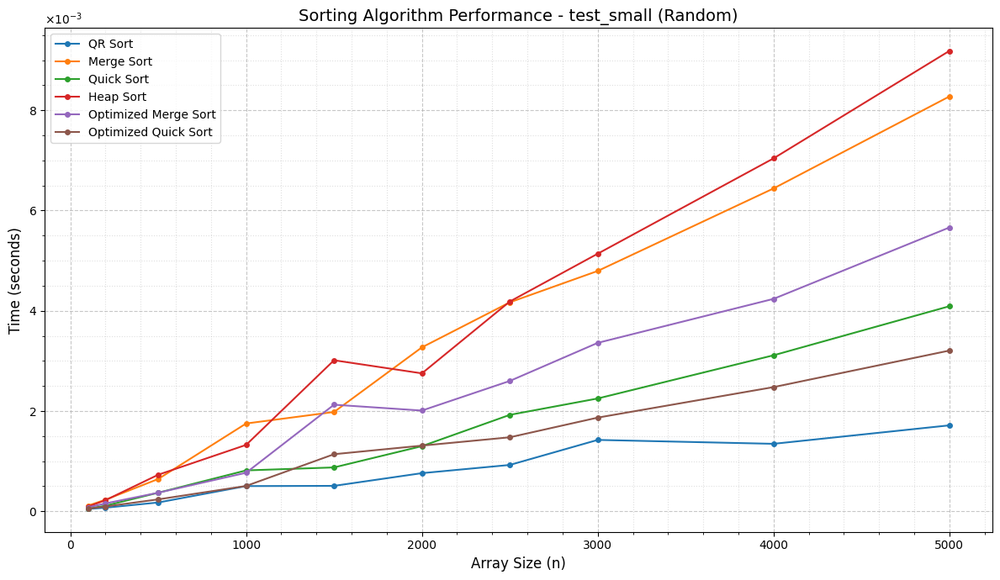


 Summary for test_small (Random) 
QR Sort: avg=7.478300e-04s, min=4.720000e-05s, max=1.714700e-03s
Merge Sort: avg=3.167100e-03s, min=1.124000e-04s, max=8.275000e-03s
Quick Sort: avg=1.490560e-03s, min=5.340000e-05s, max=4.090800e-03s
Heap Sort: avg=3.368120e-03s, min=9.210000e-05s, max=9.183600e-03s
Optimized Merge Sort: avg=2.137250e-03s, min=7.820000e-05s, max=5.661600e-03s
Optimized Quick Sort: avg=1.237080e-03s, min=5.100000e-05s, max=3.206100e-03s

!!! Running test_medium | Input: Random
Sizes: [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


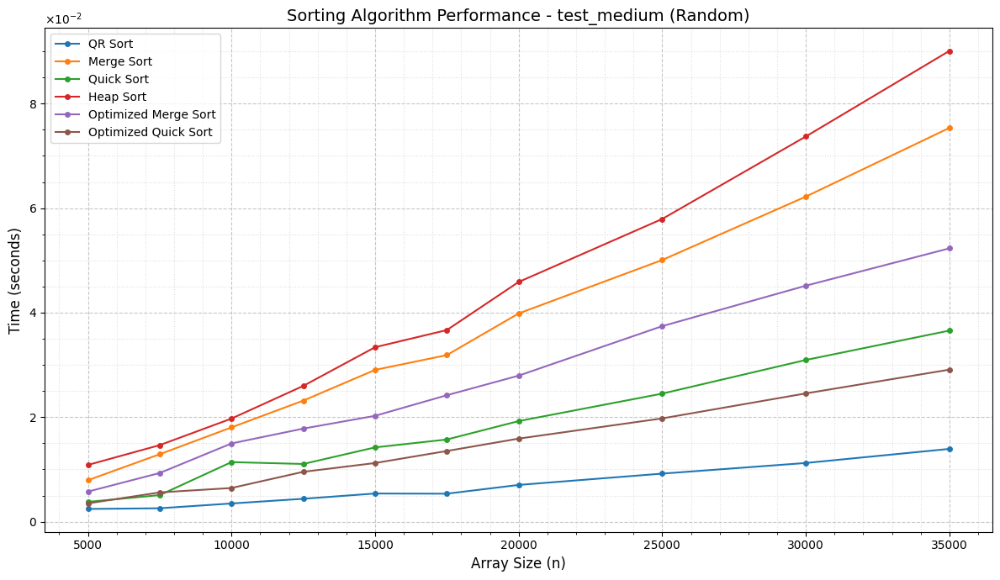


 Summary for test_medium (Random) 
QR Sort: avg=6.497210e-03s, min=2.432300e-03s, max=1.392530e-02s
Merge Sort: avg=3.504235e-02s, min=7.928500e-03s, max=7.534870e-02s
Quick Sort: avg=1.724945e-02s, min=3.791800e-03s, max=3.656370e-02s
Heap Sort: avg=4.088364e-02s, min=1.085350e-02s, max=9.008870e-02s
Optimized Merge Sort: avg=2.551037e-02s, min=5.751100e-03s, max=5.230310e-02s
Optimized Quick Sort: avg=1.391033e-02s, min=3.495100e-03s, max=2.909020e-02s

!!! Running test_large | Input: Random
Sizes: [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


KeyboardInterrupt: 

In [14]:
def run_all_comparisons():
    all_algorithms = [
        ("QR Sort", Alg.run_qr),
        ("Merge Sort", Alg.run_merge),
        ("Quick Sort", Alg.run_quick),
        ("Heap Sort", Alg.run_heap),
        ("Optimized Merge Sort", Alg.run_optimized_merge),
        ("Optimized Quick Sort", Alg.run_optimized_quick),
    ]

    # All except basic Quick Sort (it degrades to O(n^2) on sorted/reverse input)
    without_basic_quick = [
        ("QR Sort", Alg.run_qr),
        ("Merge Sort", Alg.run_merge),
        ("Heap Sort", Alg.run_heap),
        ("Optimized Merge Sort", Alg.run_optimized_merge),
        ("Optimized Quick Sort", Alg.run_optimized_quick),
    ]

    without_basic_sorts = [
        ("QR Sort", Alg.run_qr),
        ("Optimized Merge Sort", Alg.run_optimized_merge),
        ("Optimized Quick Sort", Alg.run_optimized_quick),
    ]

    all_test_sets = [
        ("test_small", test_small),
        ("test_medium", test_medium),
        ("test_large", test_large),
        ("test_xl", test_xl),
        ("test_xxl", test_xxl),
        ("test_xxxl", test_xxxl),
    ]

    # RANDOM INPUT
    print("#  RANDOM INPUT - All 6 algorithms on all 6 test sets")

    for name, sizes in all_test_sets:
        compare_and_plot(name, sizes, all_algorithms,
                         generate_random_array, "Random")
        
    # Additional for the best algs
    compare_and_plot("test_xxl", test_xxl, without_basic_sorts,
                     generate_random_array, "Random")
    compare_and_plot("test_xxxl", test_xxxl, without_basic_sorts,
                     generate_random_array, "Random")

    # SORTED INPUT (ascending)
    print("#  SORTED INPUT (ascending) - All 6 algorithms on all 6 test sets")
    print("#  Note: Basic Quick Sort included only on test_small (O(n^2) worst case)")

    # test_small with all 6 — shows Quick Sort O(n^2) degradation clearly
    compare_and_plot("test_small", test_small, all_algorithms,
                     generate_sorted_array, "Sorted (ascending)")

    # test_medium and above — exclude basic Quick Sort to avoid O(n^2) blowup
    for name, sizes in all_test_sets[1:]:
        compare_and_plot(name, sizes, without_basic_quick,
                         generate_sorted_array, "Sorted (ascending)")

    # REVERSE SORTED INPUT (descending)
    print("#  REVERSE SORTED INPUT (descending) - All 6 algorithms on all 6 test sets")
    print("#  Note: Basic Quick Sort included only on test_small (O(n^2) worst case)")

    # test_small with all 6
    compare_and_plot("test_small", test_small, all_algorithms,
                     generate_reverse_sorted_array, "Reverse sorted")

    # test_medium and above — exclude basic Quick Sort
    for name, sizes in all_test_sets[1:]:
        compare_and_plot(name, sizes, without_basic_quick,
                         generate_reverse_sorted_array, "Reverse sorted")

run_all_comparisons()


!!! Running test_xxxl | Input: Random
Sizes: [1500000, 2000000, 2500000, 5000000, 7500000, 10000000]
Algorithms: ['QR Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


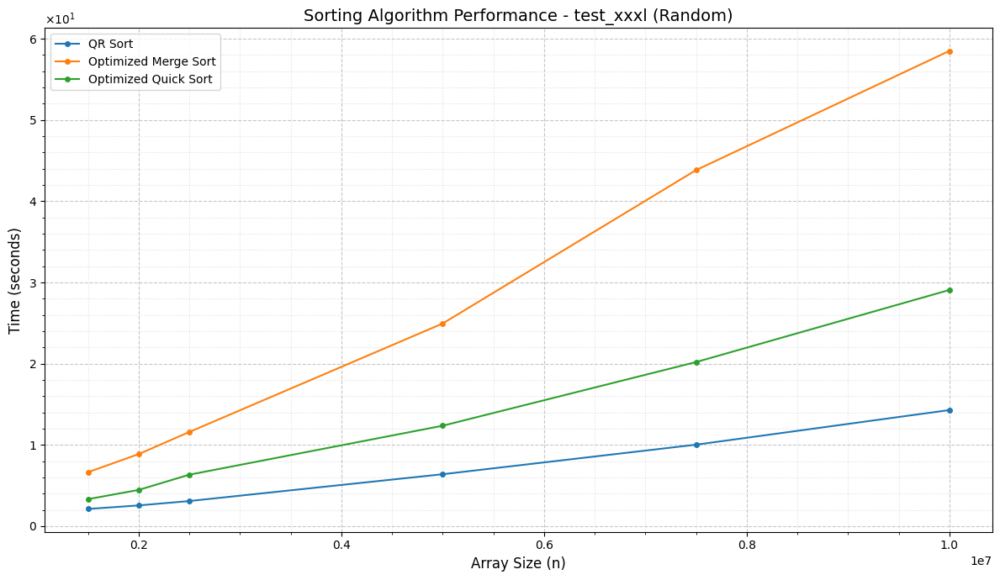


 Summary for test_xxxl (Random) 
QR Sort: avg=6.416568e+00s, min=2.122597e+00s, max=1.429512e+01s
Optimized Merge Sort: avg=2.573319e+01s, min=6.644286e+00s, max=5.850835e+01s
Optimized Quick Sort: avg=1.262923e+01s, min=3.326109e+00s, max=2.907845e+01s


In [75]:
without_basic_sorts = [
        ("QR Sort", Alg.run_qr),
        ("Optimized Merge Sort", Alg.run_optimized_merge),
        ("Optimized Quick Sort", Alg.run_optimized_quick),
    ]

compare_and_plot("test_xxxl", test_xxxl, without_basic_sorts,
                     generate_random_array, "Random")


!!! Running test_xxxxl | Input: Random
Sizes: [15000000, 20000000, 25000000, 50000000, 75000000, 100000000]
Algorithms: ['QR Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


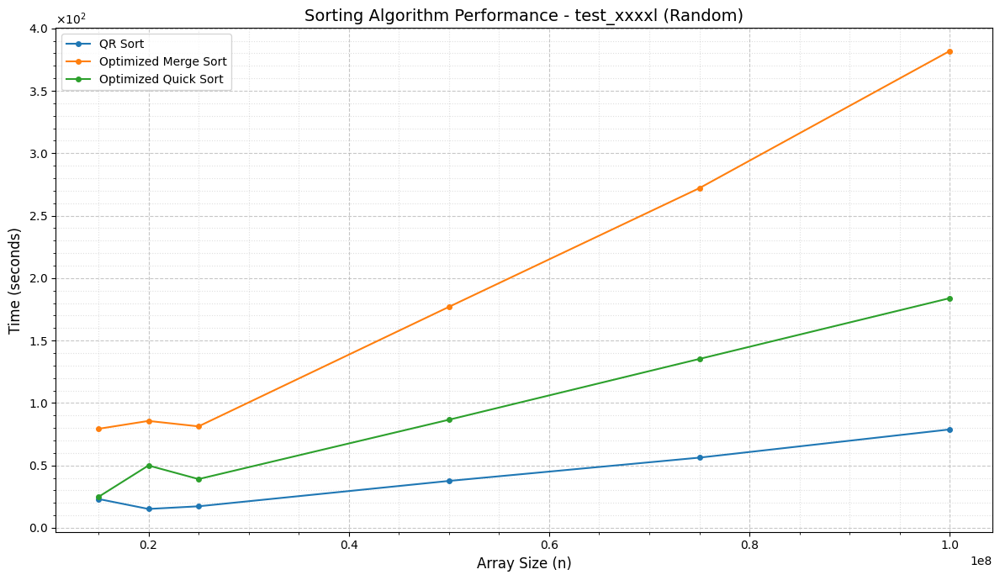


 Summary for test_xxxxl (Random) 
QR Sort: avg=3.804165e+01s, min=1.514976e+01s, max=7.883292e+01s
Optimized Merge Sort: avg=1.795351e+02s, min=7.930757e+01s, max=3.819293e+02s
Optimized Quick Sort: avg=8.660147e+01s, min=2.474383e+01s, max=1.839622e+02s


In [76]:
without_basic_sorts = [
        ("QR Sort", Alg.run_qr),
        ("Optimized Merge Sort", Alg.run_optimized_merge),
        ("Optimized Quick Sort", Alg.run_optimized_quick),
    ]

compare_and_plot("test_xxxxl", test_xxxxl, without_basic_sorts,
                     generate_random_array, "Random")

# PARTIALLY SORTED INPUT (30%, 50%, 70% pre-sorted ascending)
# Quick Sort included only on test_small (may degrade on near-sorted data)


!!! Running test_small | Input: Partially sorted (30%)
Sizes: [100, 200, 500, 1000, 1500, 2000, 2500, 3000, 4000, 5000]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


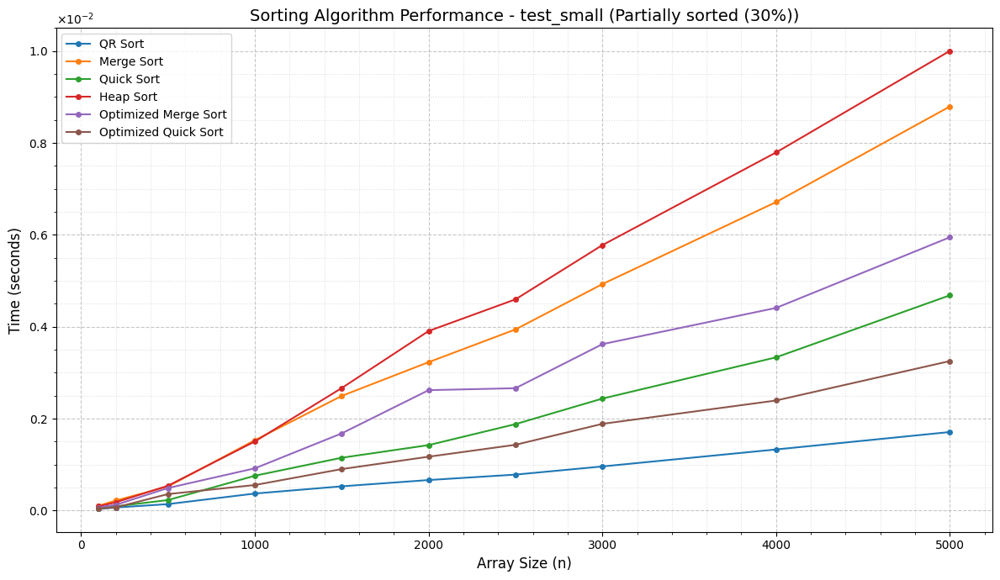


 Summary for test_small (Partially sorted (30%)) 
QR Sort: avg=6.597900e-04s, min=3.620000e-05s, max=1.710300e-03s
Merge Sort: avg=3.249390e-03s, min=1.061000e-04s, max=8.795000e-03s
Quick Sort: avg=1.604860e-03s, min=4.720000e-05s, max=4.685500e-03s
Heap Sort: avg=3.707470e-03s, min=9.350000e-05s, max=1.000430e-02s
Optimized Merge Sort: avg=2.256030e-03s, min=7.160000e-05s, max=5.948900e-03s
Optimized Quick Sort: avg=1.208300e-03s, min=4.590000e-05s, max=3.254500e-03s

!!! Running test_medium | Input: Partially sorted (30%)
Sizes: [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


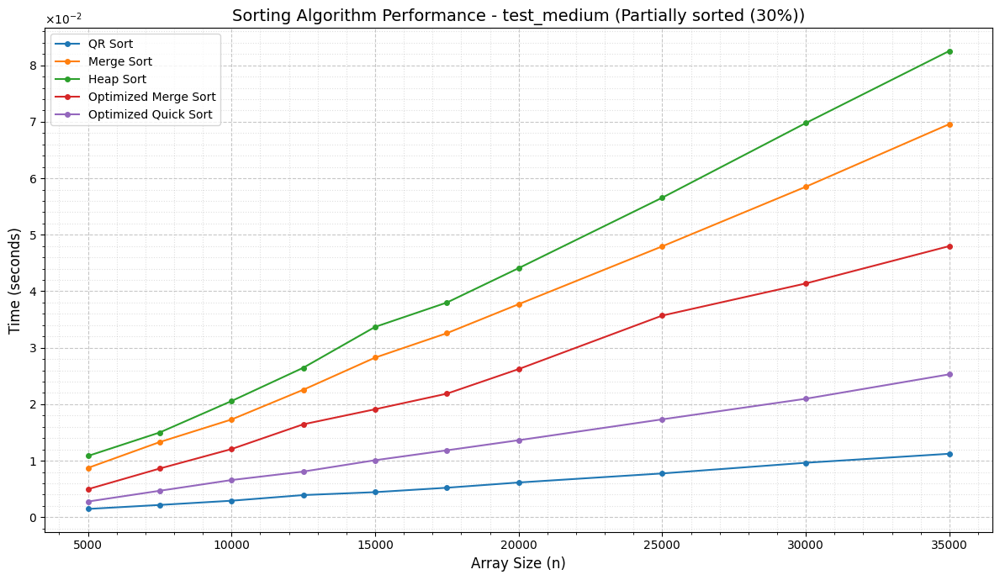


 Summary for test_medium (Partially sorted (30%)) 
QR Sort: avg=5.487230e-03s, min=1.460700e-03s, max=1.123040e-02s
Merge Sort: avg=3.364325e-02s, min=8.722000e-03s, max=6.959060e-02s
Heap Sort: avg=3.974925e-02s, min=1.083800e-02s, max=8.254240e-02s
Optimized Merge Sort: avg=2.343264e-02s, min=4.954100e-03s, max=4.799200e-02s
Optimized Quick Sort: avg=1.212418e-02s, min=2.768700e-03s, max=2.529380e-02s

!!! Running test_large | Input: Partially sorted (30%)
Sizes: [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


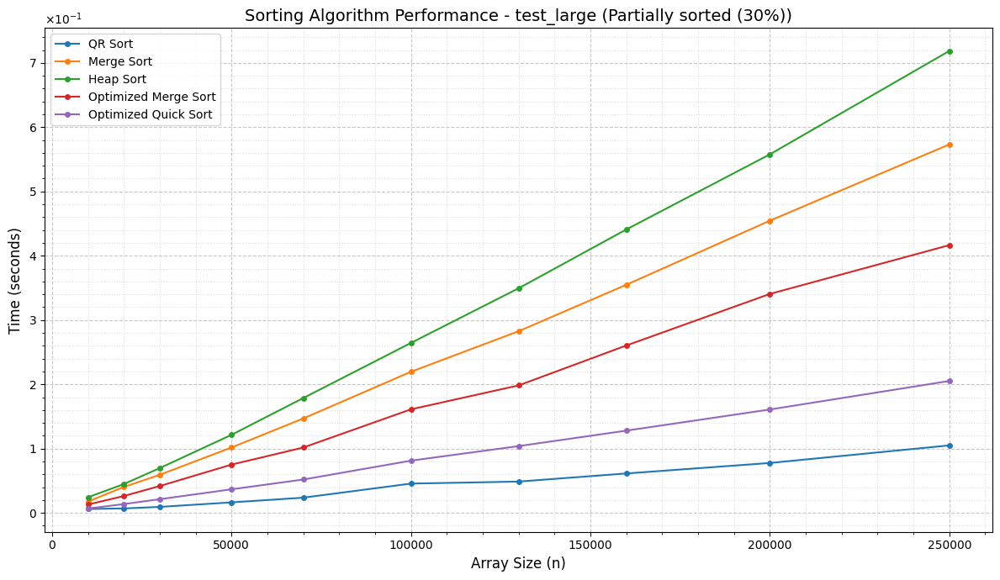


 Summary for test_large (Partially sorted (30%)) 
QR Sort: avg=4.008452e-02s, min=6.146700e-03s, max=1.050006e-01s
Merge Sort: avg=2.250511e-01s, min=1.753020e-02s, max=5.732226e-01s
Heap Sort: avg=2.769854e-01s, min=2.425350e-02s, max=7.186102e-01s
Optimized Merge Sort: avg=1.634649e-01s, min=1.296140e-02s, max=4.165147e-01s
Optimized Quick Sort: avg=8.096018e-02s, min=6.812800e-03s, max=2.052106e-01s

!!! Running test_xl | Input: Partially sorted (30%)
Sizes: [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


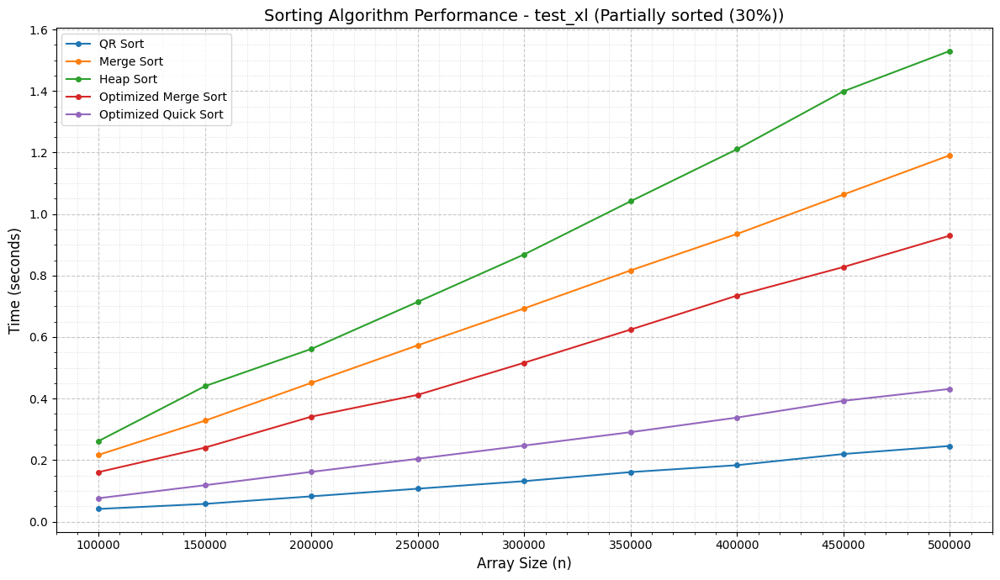


 Summary for test_xl (Partially sorted (30%)) 
QR Sort: avg=1.365576e-01s, min=4.107490e-02s, max=2.458547e-01s
Merge Sort: avg=6.966148e-01s, min=2.169395e-01s, max=1.191277e+00s
Heap Sort: avg=8.921294e-01s, min=2.617999e-01s, max=1.530506e+00s
Optimized Merge Sort: avg=5.319914e-01s, min=1.608593e-01s, max=9.298137e-01s
Optimized Quick Sort: avg=2.511520e-01s, min=7.597420e-02s, max=4.314270e-01s

!!! Running test_xxl | Input: Partially sorted (30%)
Sizes: [500000, 600000, 700000, 800000, 900000, 1000000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


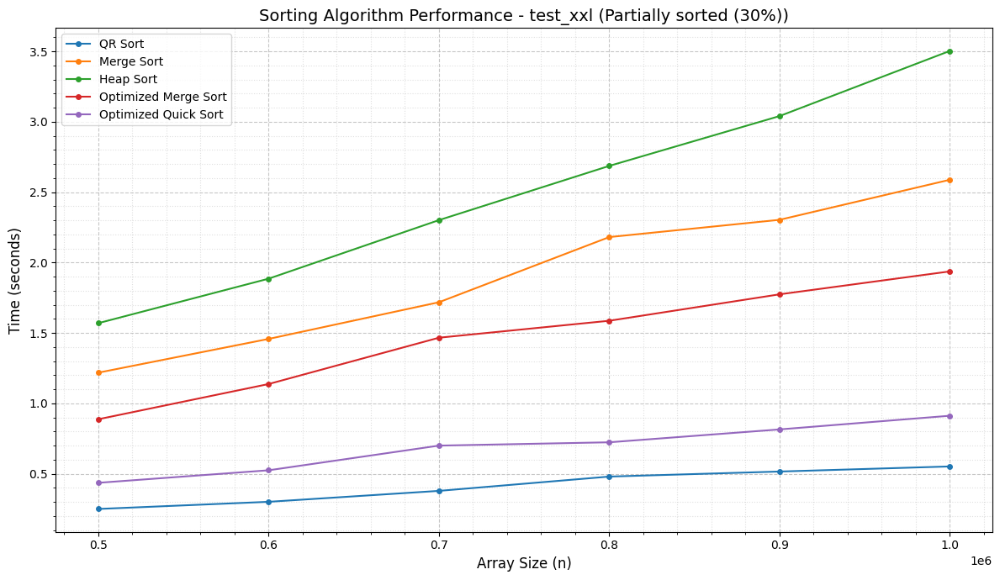


 Summary for test_xxl (Partially sorted (30%)) 
QR Sort: avg=4.126162e-01s, min=2.497736e-01s, max=5.517479e-01s
Merge Sort: avg=1.911341e+00s, min=1.218099e+00s, max=2.588500e+00s
Heap Sort: avg=2.498204e+00s, min=1.569824e+00s, max=3.503850e+00s
Optimized Merge Sort: avg=1.464967e+00s, min=8.871980e-01s, max=1.937444e+00s
Optimized Quick Sort: avg=6.850141e-01s, min=4.355490e-01s, max=9.120063e-01s

!!! Running test_small | Input: Partially sorted (50%)
Sizes: [100, 200, 500, 1000, 1500, 2000, 2500, 3000, 4000, 5000]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


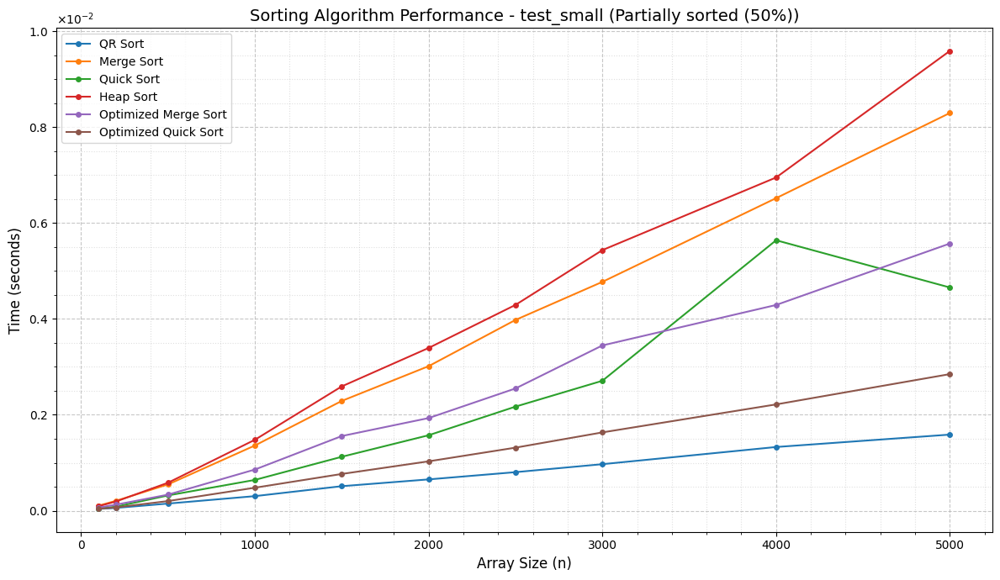


 Summary for test_small (Partially sorted (50%)) 
QR Sort: avg=6.402200e-04s, min=3.660000e-05s, max=1.587200e-03s
Merge Sort: avg=3.108680e-03s, min=1.047000e-04s, max=8.294400e-03s
Quick Sort: avg=1.896420e-03s, min=4.480000e-05s, max=5.640500e-03s
Heap Sort: avg=3.460060e-03s, min=9.370000e-05s, max=9.589000e-03s
Optimized Merge Sort: avg=2.073250e-03s, min=6.520000e-05s, max=5.572000e-03s
Optimized Quick Sort: avg=1.059920e-03s, min=3.950000e-05s, max=2.848800e-03s

!!! Running test_medium | Input: Partially sorted (50%)
Sizes: [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


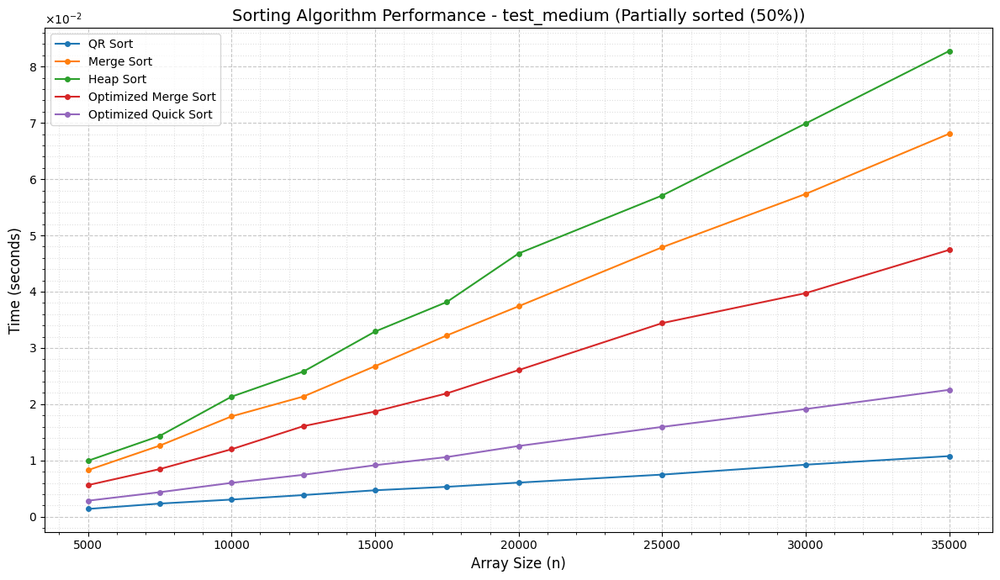


 Summary for test_medium (Partially sorted (50%)) 
QR Sort: avg=5.415270e-03s, min=1.375900e-03s, max=1.077110e-02s
Merge Sort: avg=3.298148e-02s, min=8.268200e-03s, max=6.808390e-02s
Heap Sort: avg=3.990636e-02s, min=9.932100e-03s, max=8.279250e-02s
Optimized Merge Sort: avg=2.304138e-02s, min=5.609200e-03s, max=4.743330e-02s
Optimized Quick Sort: avg=1.106234e-02s, min=2.838500e-03s, max=2.255250e-02s

!!! Running test_large | Input: Partially sorted (50%)
Sizes: [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


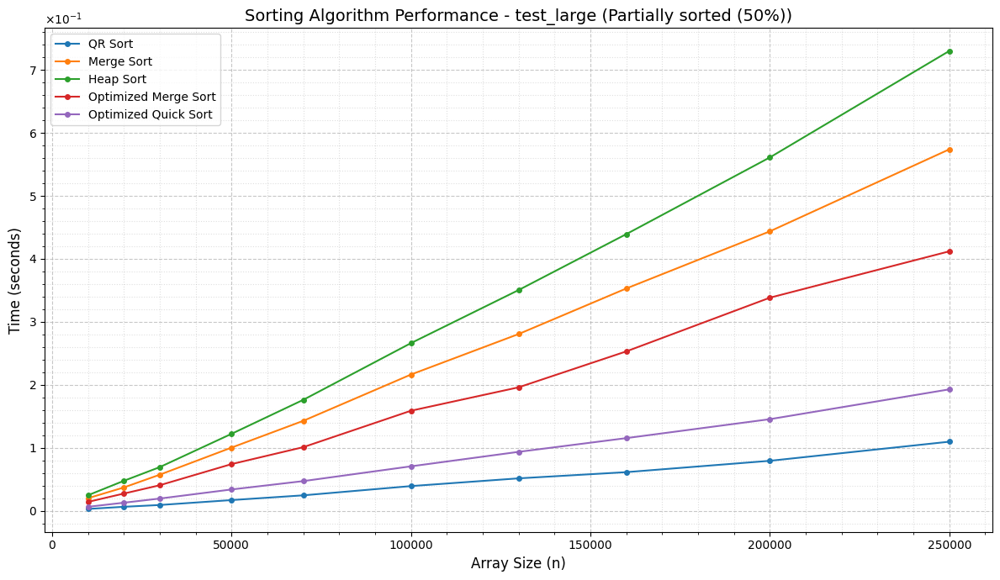


 Summary for test_large (Partially sorted (50%)) 
QR Sort: avg=4.016813e-02s, min=2.975100e-03s, max=1.097471e-01s
Merge Sort: avg=2.225170e-01s, min=1.999550e-02s, max=5.739067e-01s
Heap Sort: avg=2.787110e-01s, min=2.468400e-02s, max=7.301006e-01s
Optimized Merge Sort: avg=1.615730e-01s, min=1.413750e-02s, max=4.119947e-01s
Optimized Quick Sort: avg=7.378635e-02s, min=6.369500e-03s, max=1.928525e-01s

!!! Running test_xl | Input: Partially sorted (50%)
Sizes: [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


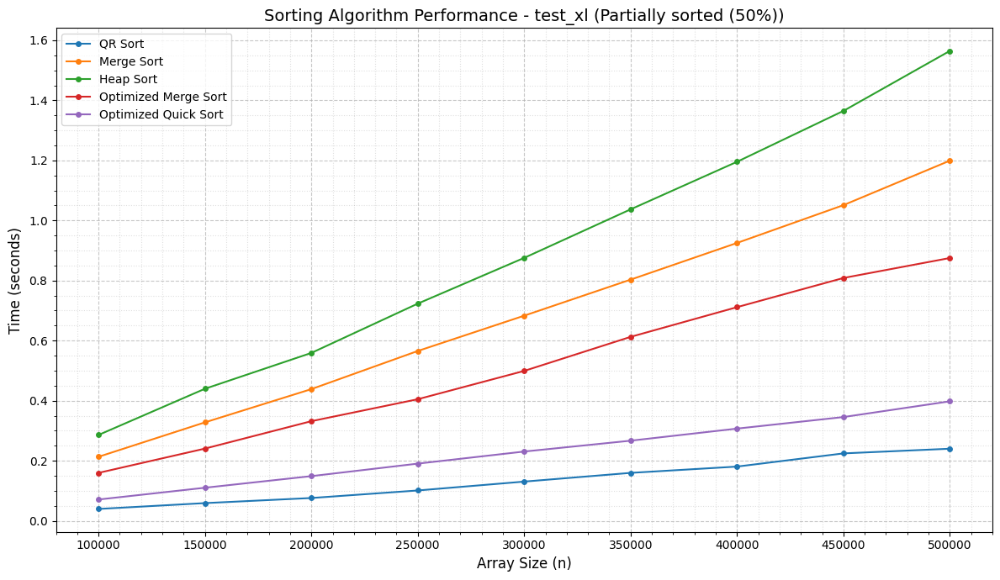


 Summary for test_xl (Partially sorted (50%)) 
QR Sort: avg=1.344317e-01s, min=3.937850e-02s, max=2.399864e-01s
Merge Sort: avg=6.896256e-01s, min=2.131096e-01s, max=1.199363e+00s
Heap Sort: avg=8.939672e-01s, min=2.858310e-01s, max=1.564768e+00s
Optimized Merge Sort: avg=5.159026e-01s, min=1.595058e-01s, max=8.750895e-01s
Optimized Quick Sort: avg=2.297110e-01s, min=7.080290e-02s, max=3.978215e-01s

!!! Running test_xxl | Input: Partially sorted (50%)
Sizes: [500000, 600000, 700000, 800000, 900000, 1000000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


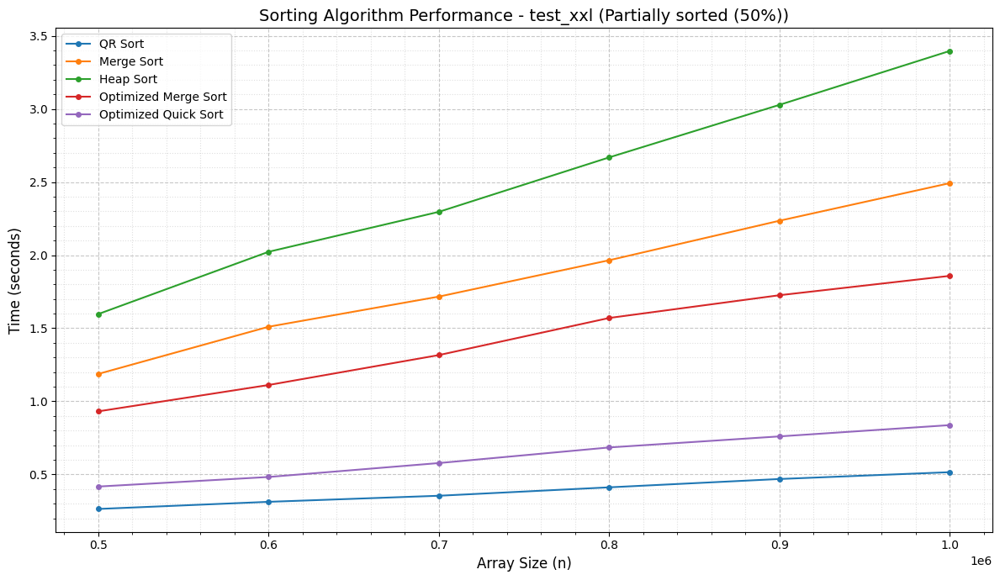


 Summary for test_xxl (Partially sorted (50%)) 
QR Sort: avg=3.876833e-01s, min=2.637549e-01s, max=5.153724e-01s
Merge Sort: avg=1.851244e+00s, min=1.187503e+00s, max=2.492613e+00s
Heap Sort: avg=2.501734e+00s, min=1.597197e+00s, max=3.396907e+00s
Optimized Merge Sort: avg=1.418979e+00s, min=9.314321e-01s, max=1.858231e+00s
Optimized Quick Sort: avg=6.265098e-01s, min=4.170208e-01s, max=8.372619e-01s

!!! Running test_small | Input: Partially sorted (70%)
Sizes: [100, 200, 500, 1000, 1500, 2000, 2500, 3000, 4000, 5000]
Algorithms: ['QR Sort', 'Merge Sort', 'Quick Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


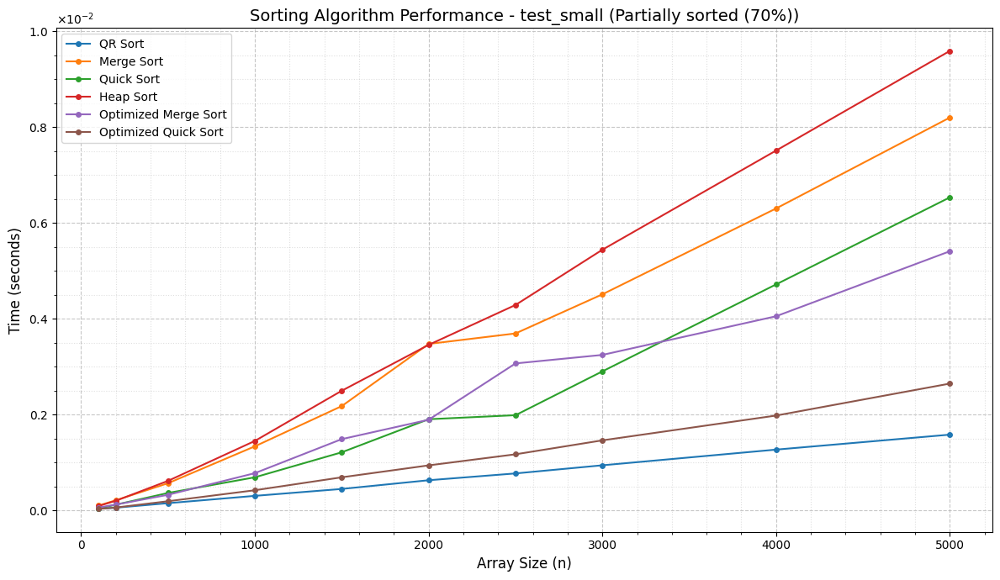


 Summary for test_small (Partially sorted (70%)) 
QR Sort: avg=6.212000e-04s, min=3.770000e-05s, max=1.583600e-03s
Merge Sort: avg=3.059770e-03s, min=1.031000e-04s, max=8.201400e-03s
Quick Sort: avg=2.049680e-03s, min=4.370000e-05s, max=6.535700e-03s
Heap Sort: avg=3.516560e-03s, min=9.420000e-05s, max=9.592200e-03s
Optimized Merge Sort: avg=2.046300e-03s, min=6.210000e-05s, max=5.411500e-03s
Optimized Quick Sort: avg=9.618200e-04s, min=3.280000e-05s, max=2.649300e-03s

!!! Running test_medium | Input: Partially sorted (70%)
Sizes: [5000, 7500, 10000, 12500, 15000, 17500, 20000, 25000, 30000, 35000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


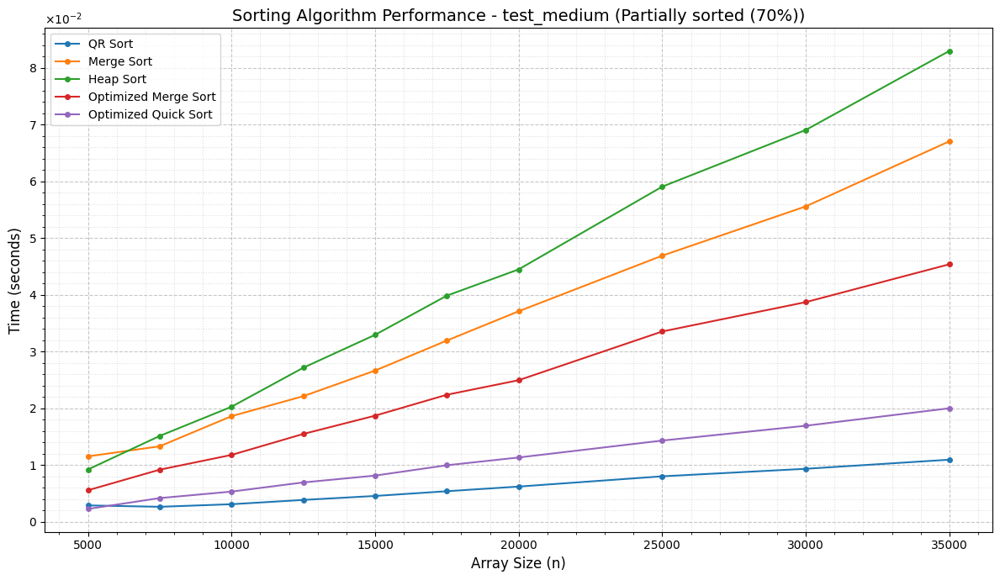


 Summary for test_medium (Partially sorted (70%)) 
QR Sort: avg=5.703520e-03s, min=2.651700e-03s, max=1.095720e-02s
Merge Sort: avg=3.309998e-02s, min=1.153860e-02s, max=6.708770e-02s
Heap Sort: avg=4.003603e-02s, min=9.225600e-03s, max=8.302140e-02s
Optimized Merge Sort: avg=2.258333e-02s, min=5.563100e-03s, max=4.540810e-02s
Optimized Quick Sort: avg=9.950340e-03s, min=2.272000e-03s, max=2.002090e-02s

!!! Running test_large | Input: Partially sorted (70%)
Sizes: [10000, 20000, 30000, 50000, 70000, 100000, 130000, 160000, 200000, 250000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


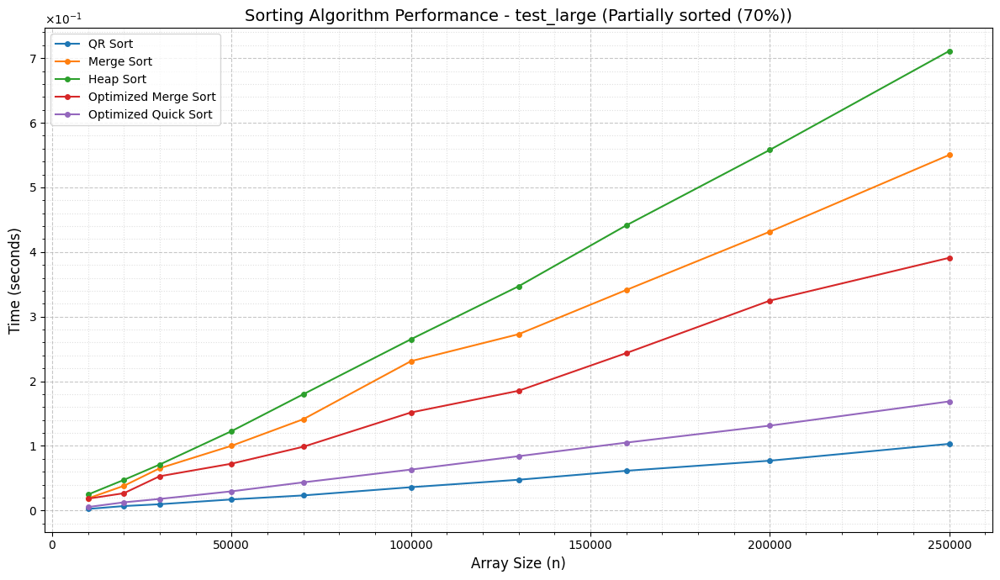


 Summary for test_large (Partially sorted (70%)) 
QR Sort: avg=3.851254e-02s, min=2.428300e-03s, max=1.031840e-01s
Merge Sort: avg=2.191042e-01s, min=1.872740e-02s, max=5.503761e-01s
Heap Sort: avg=2.768849e-01s, min=2.469250e-02s, max=7.112575e-01s
Optimized Merge Sort: avg=1.565928e-01s, min=1.830320e-02s, max=3.911298e-01s
Optimized Quick Sort: avg=6.620388e-02s, min=5.400900e-03s, max=1.688475e-01s

!!! Running test_xl | Input: Partially sorted (70%)
Sizes: [100000, 150000, 200000, 250000, 300000, 350000, 400000, 450000, 500000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


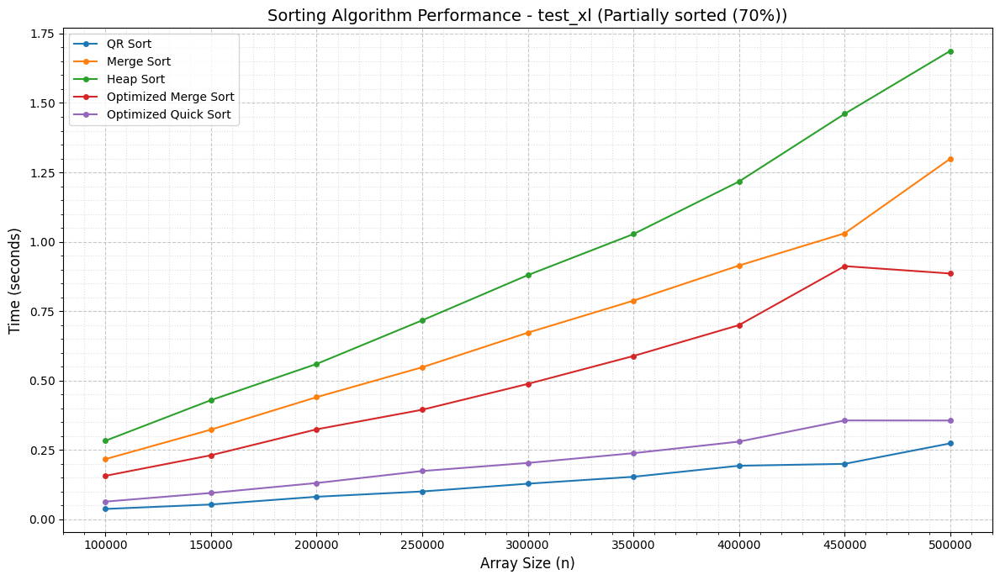


 Summary for test_xl (Partially sorted (70%)) 
QR Sort: avg=1.358003e-01s, min=3.756650e-02s, max=2.737749e-01s
Merge Sort: avg=6.925410e-01s, min=2.170302e-01s, max=1.298994e+00s
Heap Sort: avg=9.180697e-01s, min=2.833416e-01s, max=1.687476e+00s
Optimized Merge Sort: avg=5.201733e-01s, min=1.568801e-01s, max=9.122653e-01s
Optimized Quick Sort: avg=2.109780e-01s, min=6.403750e-02s, max=3.563870e-01s

!!! Running test_xxl | Input: Partially sorted (70%)
Sizes: [500000, 600000, 700000, 800000, 900000, 1000000]
Algorithms: ['QR Sort', 'Merge Sort', 'Heap Sort', 'Optimized Merge Sort', 'Optimized Quick Sort']


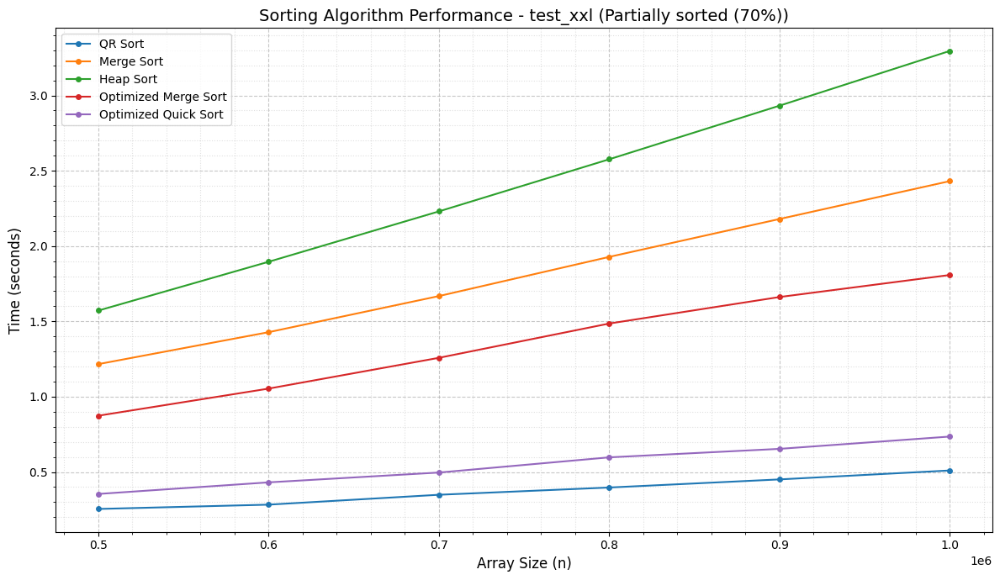


 Summary for test_xxl (Partially sorted (70%)) 
QR Sort: avg=3.741185e-01s, min=2.546676e-01s, max=5.101382e-01s
Merge Sort: avg=1.808542e+00s, min=1.216218e+00s, max=2.431132e+00s
Heap Sort: avg=2.416833e+00s, min=1.571707e+00s, max=3.295399e+00s
Optimized Merge Sort: avg=1.356767e+00s, min=8.737210e-01s, max=1.807886e+00s
Optimized Quick Sort: avg=5.446923e-01s, min=3.542864e-01s, max=7.352907e-01s


In [77]:
# --- Partially Sorted Arrays (30–70% pre-sorted in ascending order) ---

def generate_partially_sorted_array(n, sorted_fraction):
    """
    Generate an array where `sorted_fraction` (0.0–1.0) of the elements
    are already in sorted (ascending) position, and the rest are random.
    """
    arr = list(range(n))  # perfectly sorted base
    num_to_shuffle = int(n * (1 - sorted_fraction))
    # Pick random indices to scramble
    indices = random.sample(range(n), num_to_shuffle)
    values = [arr[i] for i in indices]
    random.shuffle(values)
    for idx, val in zip(indices, values):
        arr[idx] = val
    return arr


all_algorithms = [
    ("QR Sort", Alg.run_qr),
    ("Merge Sort", Alg.run_merge),
    ("Quick Sort", Alg.run_quick),
    ("Heap Sort", Alg.run_heap),
    ("Optimized Merge Sort", Alg.run_optimized_merge),
    ("Optimized Quick Sort", Alg.run_optimized_quick),
]

without_basic_quick = [
    ("QR Sort", Alg.run_qr),
    ("Merge Sort", Alg.run_merge),
    ("Heap Sort", Alg.run_heap),
    ("Optimized Merge Sort", Alg.run_optimized_merge),
    ("Optimized Quick Sort", Alg.run_optimized_quick),
]

test_sets_up_to_xxl = [
    ("test_small", test_small),
    ("test_medium", test_medium),
    ("test_large", test_large),
    ("test_xl", test_xl),
    ("test_xxl", test_xxl),
]

sorted_fractions = [0.30, 0.50, 0.70]

print("# PARTIALLY SORTED INPUT (30%, 50%, 70% pre-sorted ascending)")
print("# Quick Sort included only on test_small (may degrade on near-sorted data)\n")

for frac in sorted_fractions:
    pct = int(frac * 100)
    gen = lambda n, f=frac: generate_partially_sorted_array(n, f)
    gen_name = f"Partially sorted ({pct}%)"

    # test_small with all 6 algorithms (including basic Quick Sort)
    compare_and_plot("test_small", test_small, all_algorithms, gen, gen_name)

    # test_medium and above — drop basic Quick Sort to stay safe
    for name, sizes in test_sets_up_to_xxl[1:]:
        compare_and_plot(name, sizes, without_basic_quick, gen, gen_name)


In [22]:
# --- Sorting Animation (generic - works with any sorting algorithm) ---

import matplotlib.animation as animation
from IPython.display import HTML


class TrackedArray(list):
    """
    A list subclass that records a snapshot every time an element is written.
    Works with any in-place sorting algorithm without modifications.
    """
    def __init__(self, data):
        super().__init__(data)
        self._snapshots = []

    def __setitem__(self, key, value):
        super().__setitem__(key, value)
        if isinstance(key, int):
            self._snapshots.append((list(self), key))


def animate_sort(algorithm, size, generator, seed=42):
    """
    Animate any sorting algorithm step-by-step as a bar chart.

    Parameters
    ----------
    algorithm : tuple (name: str, func: callable)
        e.g. ("Quick Sort", Alg.run_quick)
    size : int
        Number of elements to sort.
    generator : callable(n) -> list
        Array generator function.
    seed : int
        Random seed for reproducibility.

    Returns
    -------
    HTML animation playable in Jupyter / VS Code notebooks.
    """
    name, func = algorithm

    random.seed(seed)
    data = generator(size)

    arr = TrackedArray(data)
    initial_state = list(arr)

    # Run the sorting algorithm - every arr[i]=v write is recorded
    func(arr)

    snapshots = arr._snapshots

    # Subsample to ~400 frames max so the animation stays snappy
    max_frames = 400
    if len(snapshots) > max_frames:
        step = len(snapshots) / max_frames
        indices = sorted(set(int(i * step) for i in range(max_frames)))
        indices.append(len(snapshots) - 1)
        snapshots = [snapshots[i] for i in indices]

    # Build frame list: initial -> intermediate -> final sorted
    frames = [(initial_state, -1)] + snapshots + [(list(arr), -1)]

    fig, ax = plt.subplots(figsize=(12, 5))
    max_val = max(initial_state) * 1.1
    ax.set_ylim(0, max_val)

    bars = ax.bar(range(size), frames[0][0],
                  color='steelblue', edgecolor='black', linewidth=0.3)
    ax.set_title(f'{name} Animation  |  {size} elements', fontsize=14)
    ax.set_xlabel('Index')
    ax.set_ylabel('Value')

    info_text = ax.text(
        0.02, 0.95, '', transform=ax.transAxes,
        fontsize=10, verticalalignment='top', fontfamily='monospace',
        bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

    def update(frame_idx):
        state, active_idx = frames[frame_idx]
        is_last = (frame_idx == len(frames) - 1)

        for i, bar in enumerate(bars):
            bar.set_height(state[i])
            if is_last:
                bar.set_color('limegreen')
            elif i == active_idx:
                bar.set_color('crimson')
            else:
                bar.set_color('steelblue')

        if is_last:
            info_text.set_text(f'Sorted!  ({len(frames) - 1} steps)')
        else:
            info_text.set_text(f'Step {frame_idx} / {len(frames) - 2}')

        return list(bars) + [info_text]

    interval = max(10, 5000 // len(frames))

    anim = animation.FuncAnimation(
        fig, update, frames=len(frames),
        interval=interval, blit=True, repeat=False
    )
    plt.close(fig)
    return HTML(anim.to_jshtml())


# --- Example usage ---
animate_sort(("Opt Quick Sort", Alg.run_optimized_merge), size=1000, generator=generate_random_array)